In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import pandas as pd
import spectrum
from pyleoclim import Spectral
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter, FormatStrFormatter
import LMRt
from tqdm import tqdm

In [2]:
def run_wwz(series, xlim=[0, 0.05], label='WWZ', loglog=False, title=None):
    time = series.index.values
    signal = series.values
    tau = np.linspace(np.min(time), np.max(time), 51)
    res_psd = Spectral.wwz_psd(signal, time, tau=tau, nMC=0, standardize=False)
    
    sns.set(style='ticks', font_scale=1.5)
    fig = plt.figure(figsize=[10, 10])                                                                                                                                           
    ax_signal = plt.subplot(2, 1, 1)
    ax_signal.plot(time, signal, label='signal')                                                                                                                                                          
    ax_signal.spines['right'].set_visible(False)
    ax_signal.spines['top'].set_visible(False)
    ax_signal.set_ylabel('Value')
    ax_signal.set_xlabel('Time')
    if title:
        ax_signal.set_title(title)
    
    ax_spec = plt.subplot(2, 1, 2)
    if loglog:
        ax_spec.loglog(res_psd.freqs, res_psd.psd, lw=3, label=label)                                                                                                                                                          
    else:
        ax_spec.plot(res_psd.freqs, res_psd.psd, lw=3, label=label)                                                                                                                                                          
        ax_spec.set_xlim(xlim)
        
    ax_spec.get_xaxis().set_major_formatter(ScalarFormatter())
    ax_spec.xaxis.set_major_formatter(FormatStrFormatter('%g'))
    ax_spec.set_ylabel('Spectral Density')                                                                                                                                                 
    ax_spec.set_xlabel('Frequency')                                                                                                                                                   
    ax_spec.legend(frameon=False)
    ax_spec.spines['right'].set_visible(False)
    ax_spec.spines['top'].set_visible(False)
    
    return fig, res_psd

# creat a DataFrame to store the data
df = pd.DataFrame()

## Constant frequency signal

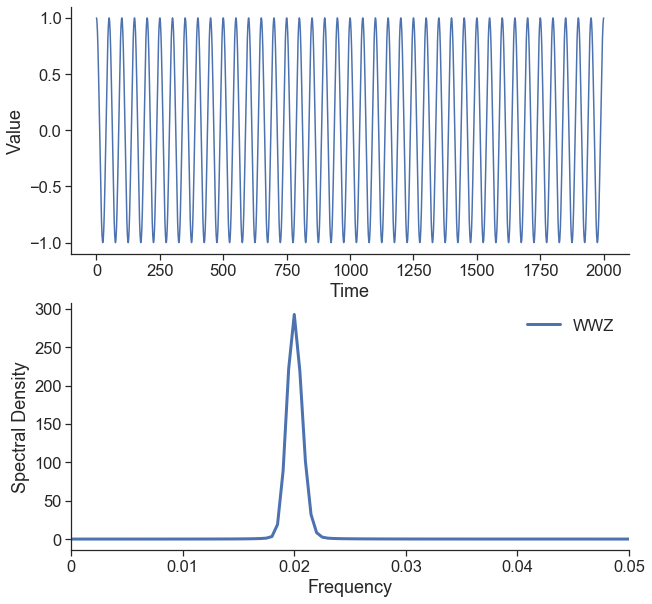

In [3]:
time = np.arange(2001)
f = 1/50
signal = np.cos(2*np.pi*f*time)

series = pd.Series(signal, index=time)
df['const_freq'] = series

fig, res_psd = run_wwz(series)

## Two constant frequencies

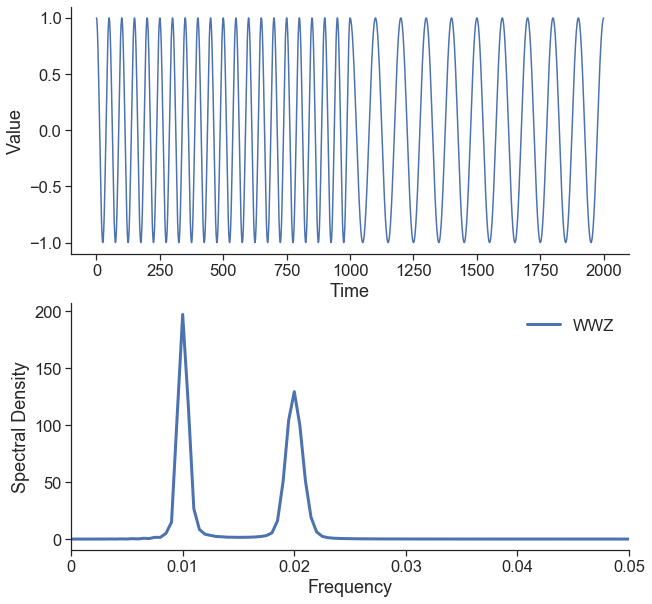

In [4]:
time1 = np.arange(1000)
f1 = 1/50
signal1 = np.cos(2*np.pi*f1*time1)

time2 = np.arange(1000, 2001)
f2 = 1/100
signal2 = np.cos(2*np.pi*f2*time2)

signal = np.concatenate([signal1, signal2])
time = np.concatenate([time1, time2])

series = pd.Series(signal, index=time)
df['two_freqs'] = series

fig, res_psd = run_wwz(series)

## Two close constant frequencies

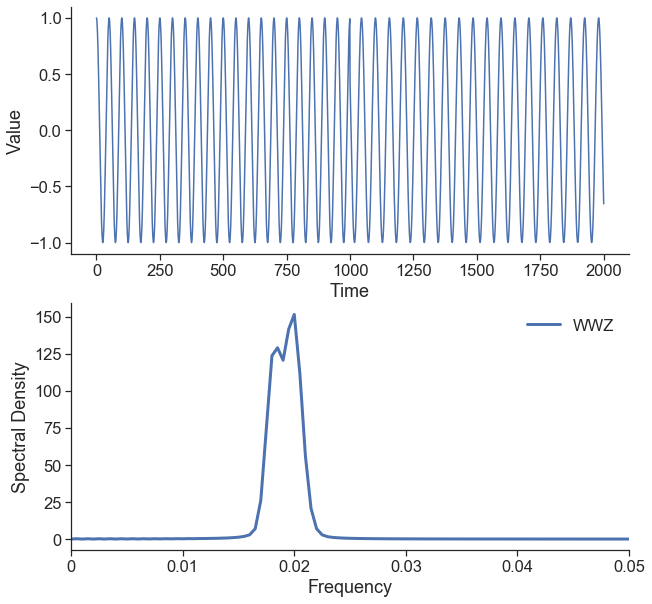

In [5]:
time1 = np.arange(1000)
f1 = 1/50
signal1 = np.cos(2*np.pi*f1*time1)

time2 = np.arange(1000, 2001)
f2 = 1/55
signal2 = np.cos(2*np.pi*f2*time2)

signal = np.concatenate([signal1, signal2])
time = np.concatenate([time1, time2])

series = pd.Series(signal, index=time)
df['two_close_freqs'] = series

fig, res_psd = run_wwz(series)

## Variant frequencies

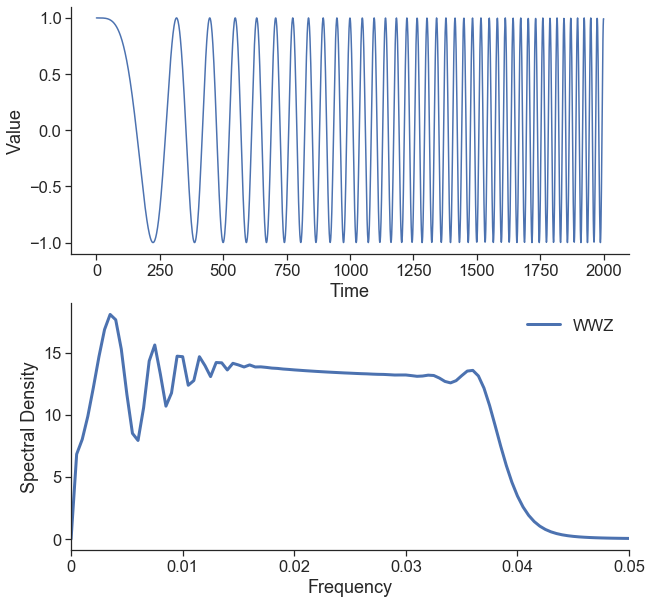

In [6]:
time = np.arange(2001)
f = 1/100000*(time+1)
signal = np.cos(2*np.pi*f*time)

series = pd.Series(signal, index=time)
df['variant_freqs'] = series

fig, res_psd = run_wwz(series)

## Colored noise

/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.


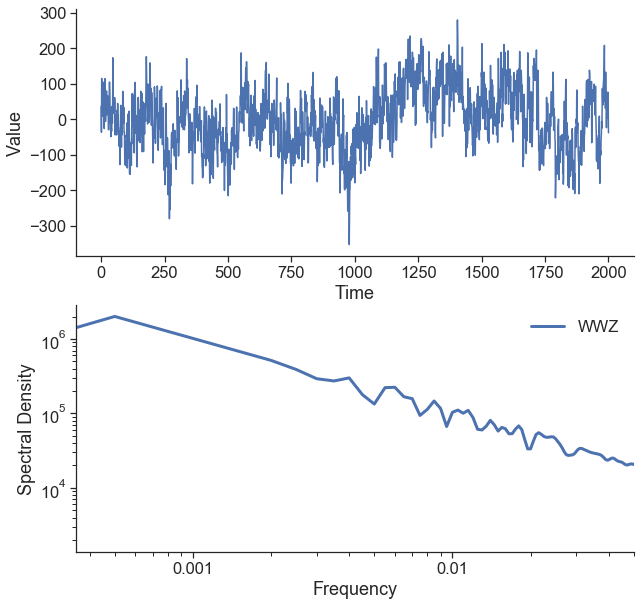

In [7]:
time = np.arange(2001)
signal = LMRt.utils.colored_noise(1, time, seed=2333)

series = pd.Series(signal, index=time)
df['colored_beta1'] = series

fig, res_psd = run_wwz(series, loglog=True)

## Colored noise with two regiems

/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.


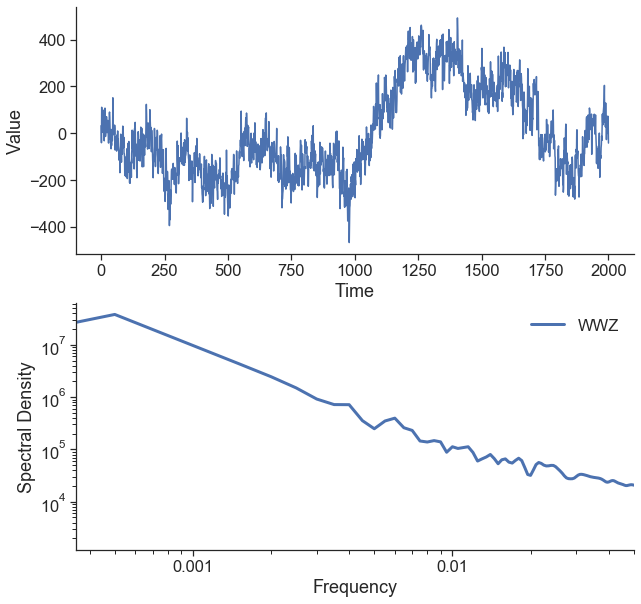

In [8]:
time = np.arange(2001)
signal = LMRt.utils.colored_noise_2regimes(1, 2, 1/100, time, seed=2333)

series = pd.Series(signal, index=time)
df['colored_beta1_2regimes'] = series

fig, res_psd = run_wwz(series, loglog=True)

## add white noise with different SNRs

  0%|          | 0/6 [00:00<?, ?it/s]

['const_freq' 'two_freqs' 'two_close_freqs' 'variant_freqs'
 'colored_beta1' 'colored_beta1_2regimes']


 67%|██████▋   | 4/6 [00:26<00:13,  6.53s/it]/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
100%|██████████| 6/6 [00:39<00:00,  6.59s/it]


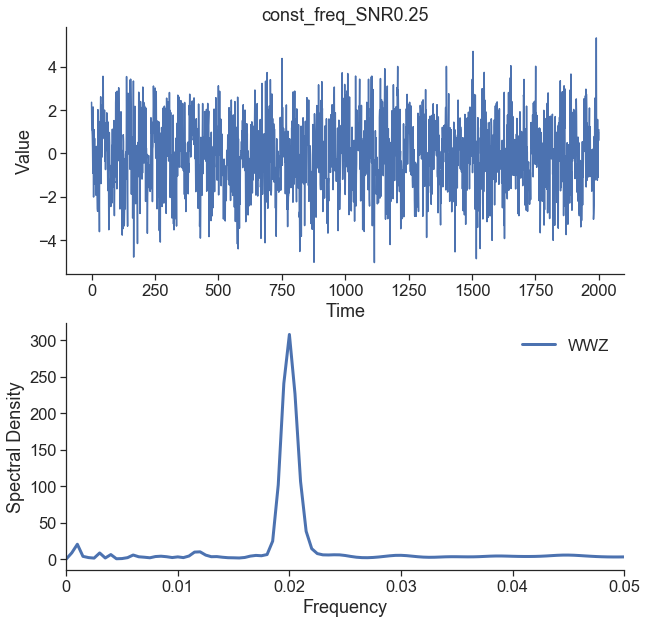

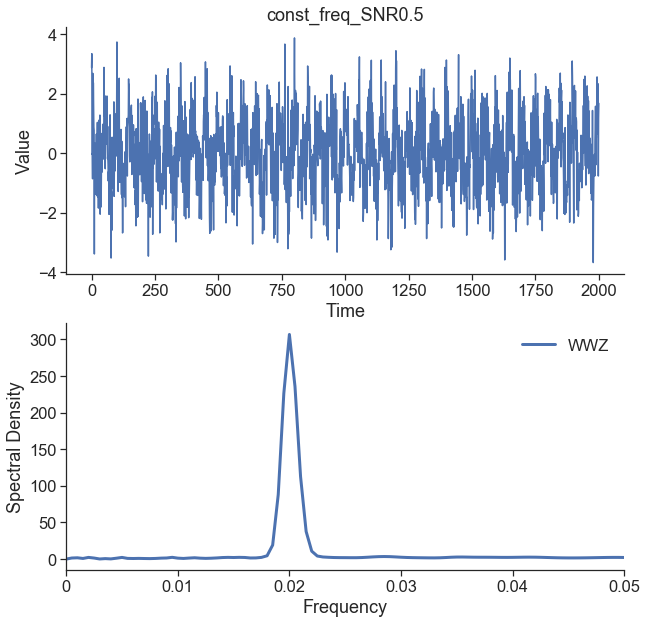

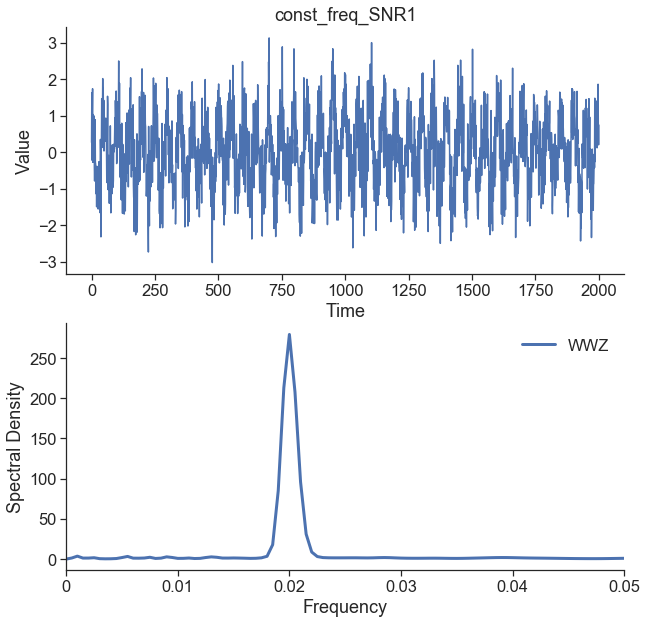

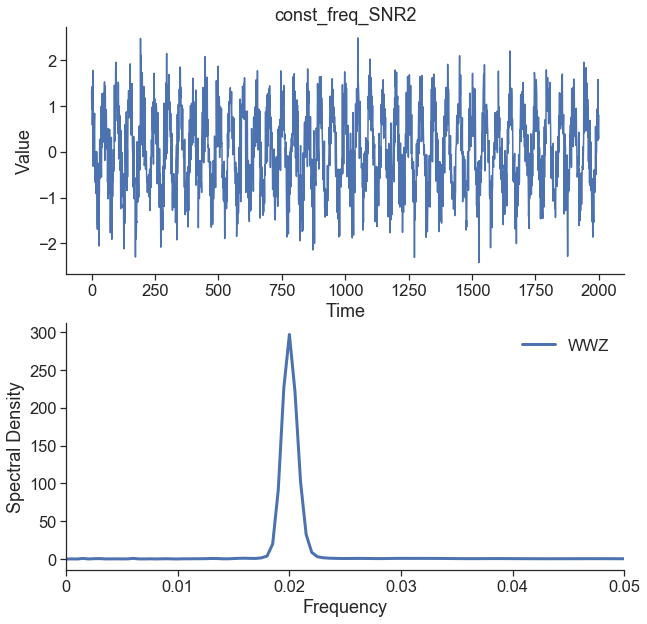

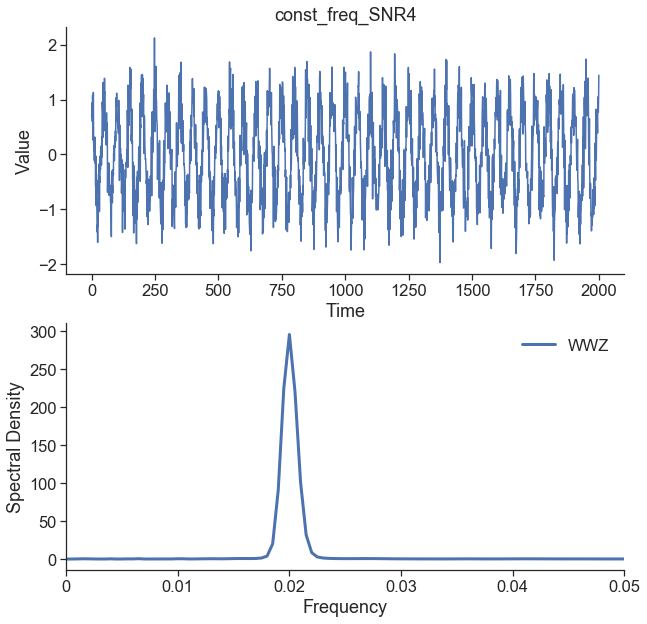

...

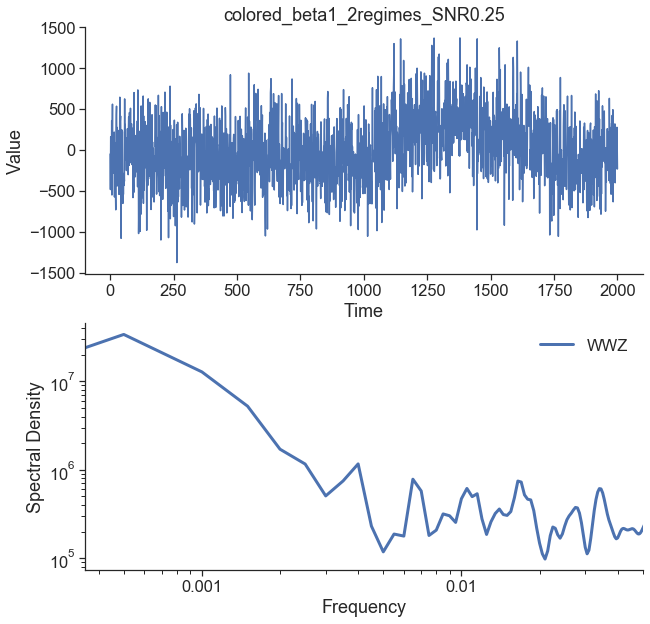

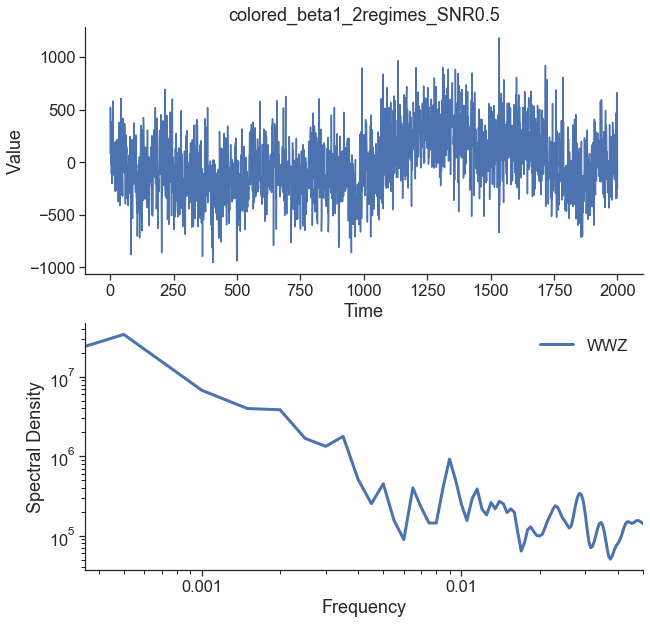

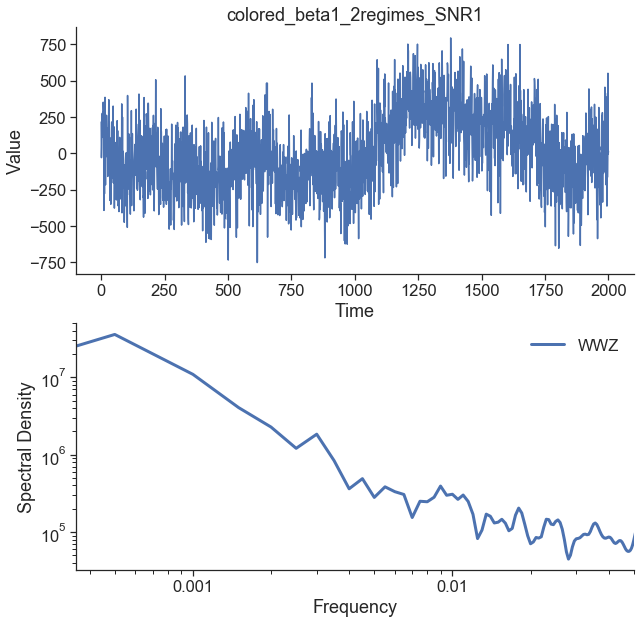

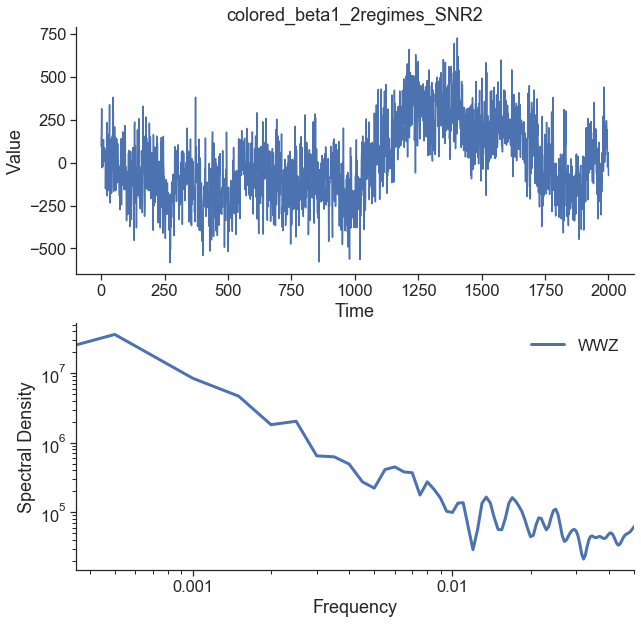

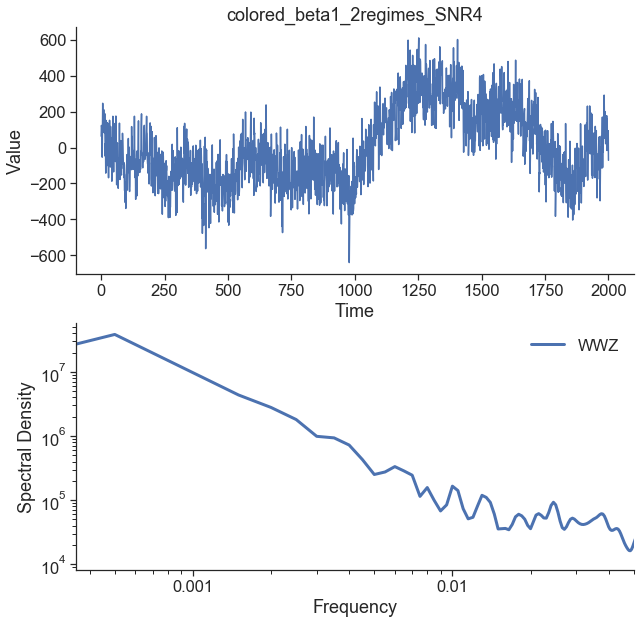

In [9]:
np.random.seed(2333)
case_list = df.columns.values
print(case_list)
for case_tag in tqdm(case_list):
    for SNR in [0.25, 0.5, 1, 2, 4]:
        signal = df[case_tag].values
        time = df[case_tag].index
        sig_var = np.var(signal)
        noise_var = sig_var / SNR
        white_noise = np.random.normal(0, np.sqrt(noise_var), size=np.size(signal))
        signal_noise = signal + white_noise
        series = pd.Series(signal_noise, index=time)
        
        col_tag = f'{case_tag}_SNR{SNR}'
        df[col_tag] = series
        
        if 'colored' in case_tag:
            loglog=True
        else:
            loglog=False
            
        fig, res_psd = run_wwz(series, title=col_tag, loglog=loglog)

## randomly delete data points

  0%|          | 0/36 [00:00<?, ?it/s]

['const_freq' 'two_freqs' 'two_close_freqs' 'variant_freqs'
 'colored_beta1' 'colored_beta1_2regimes' 'const_freq_SNR0.25'
 'const_freq_SNR0.5' 'const_freq_SNR1' 'const_freq_SNR2' 'const_freq_SNR4'
 'two_freqs_SNR0.25' 'two_freqs_SNR0.5' 'two_freqs_SNR1' 'two_freqs_SNR2'
 'two_freqs_SNR4' 'two_close_freqs_SNR0.25' 'two_close_freqs_SNR0.5'
 'two_close_freqs_SNR1' 'two_close_freqs_SNR2' 'two_close_freqs_SNR4'
 'variant_freqs_SNR0.25' 'variant_freqs_SNR0.5' 'variant_freqs_SNR1'
 'variant_freqs_SNR2' 'variant_freqs_SNR4' 'colored_beta1_SNR0.25'
 'colored_beta1_SNR0.5' 'colored_beta1_SNR1' 'colored_beta1_SNR2'
 'colored_beta1_SNR4' 'colored_beta1_2regimes_SNR0.25'
 'colored_beta1_2regimes_SNR0.5' 'colored_beta1_2regimes_SNR1'
 'colored_beta1_2regimes_SNR2' 'colored_beta1_2regimes_SNR4']


 11%|█         | 4/36 [00:07<00:57,  1.79s/it]/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
 14%|█▍        | 5/36 [00:08<00:55,  1.80s/it]/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
100%|██████████| 36/36 [01:08<00:00,  1.90s/it]


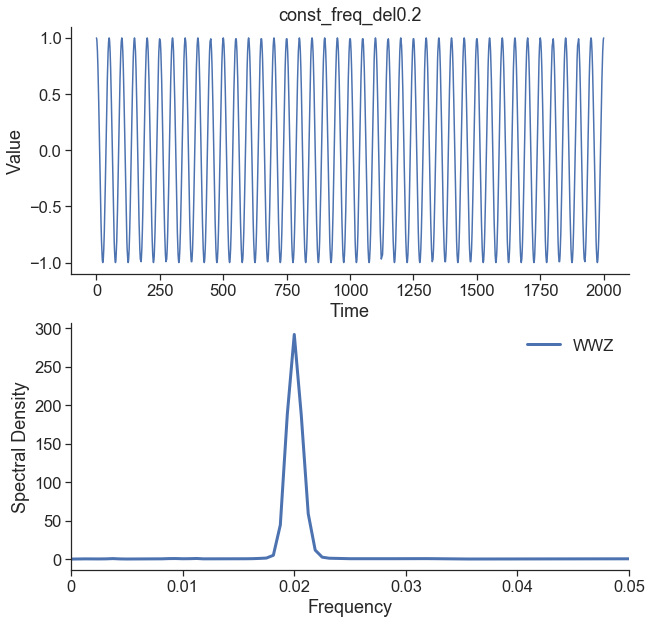

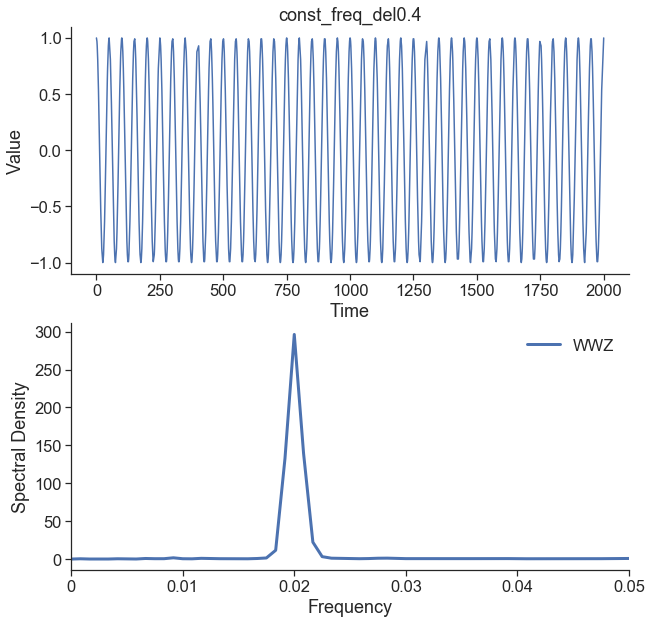

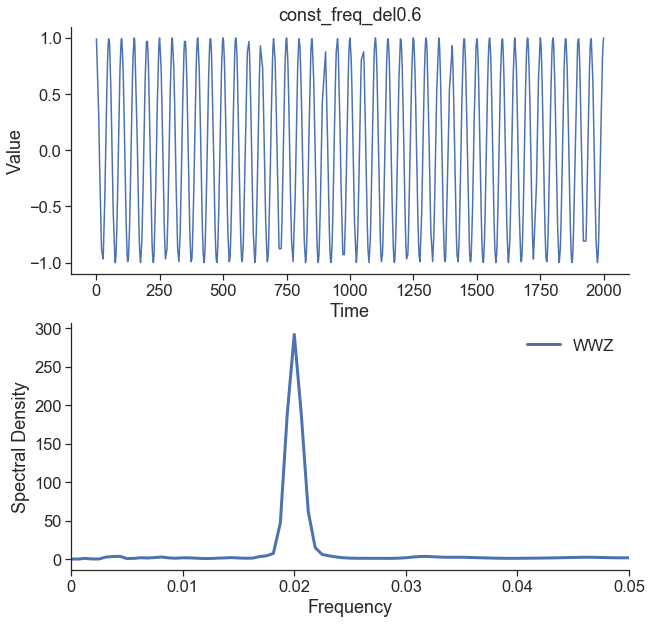

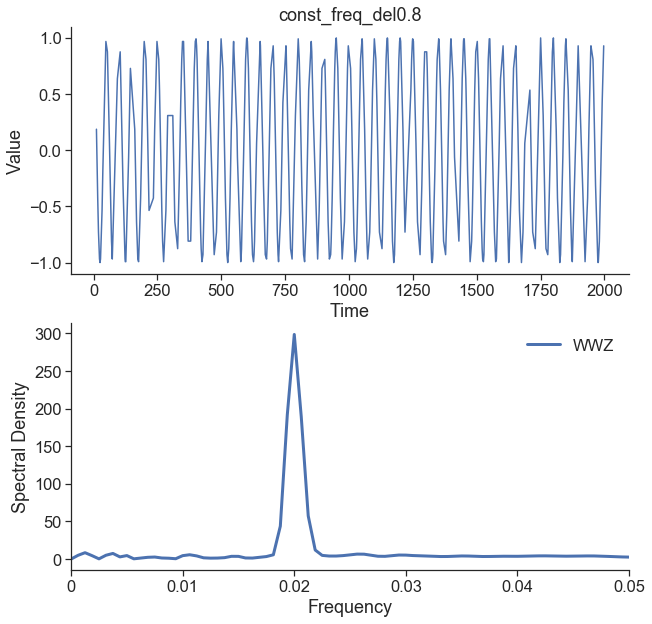

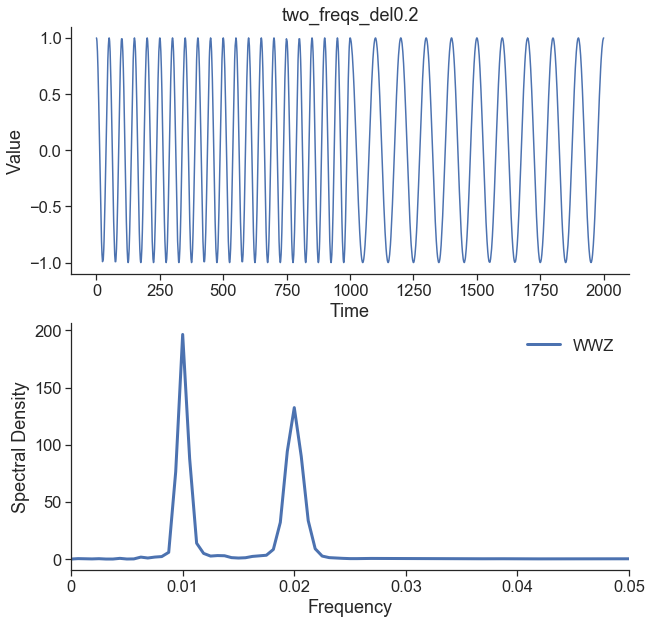

...

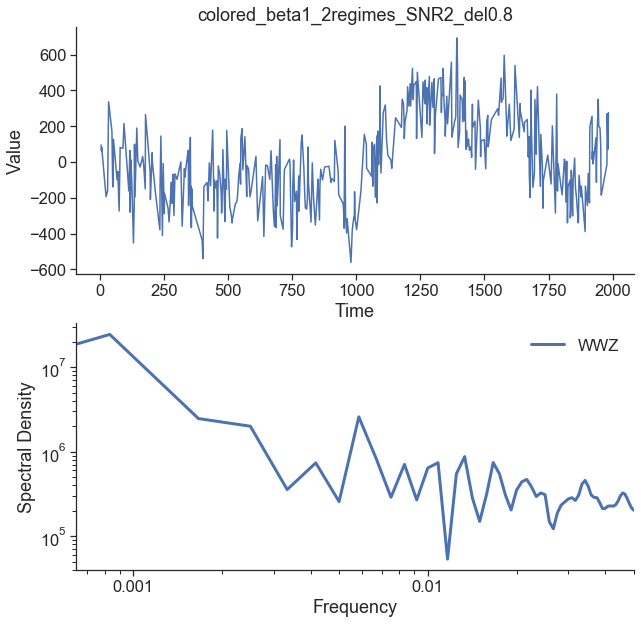

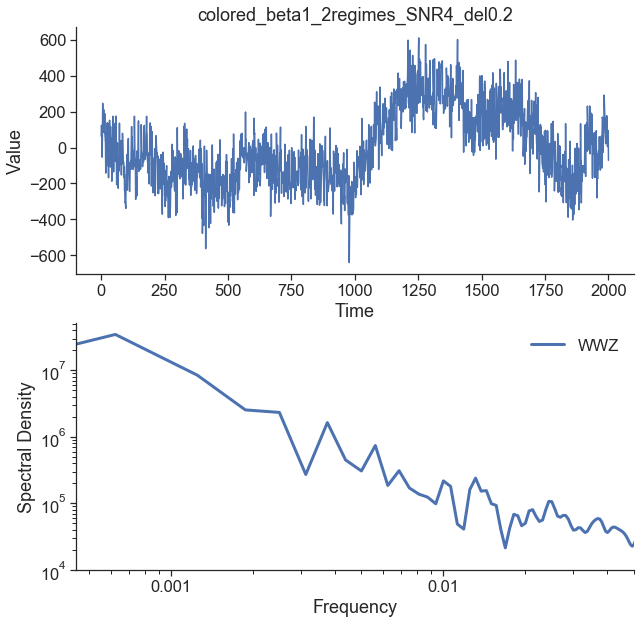

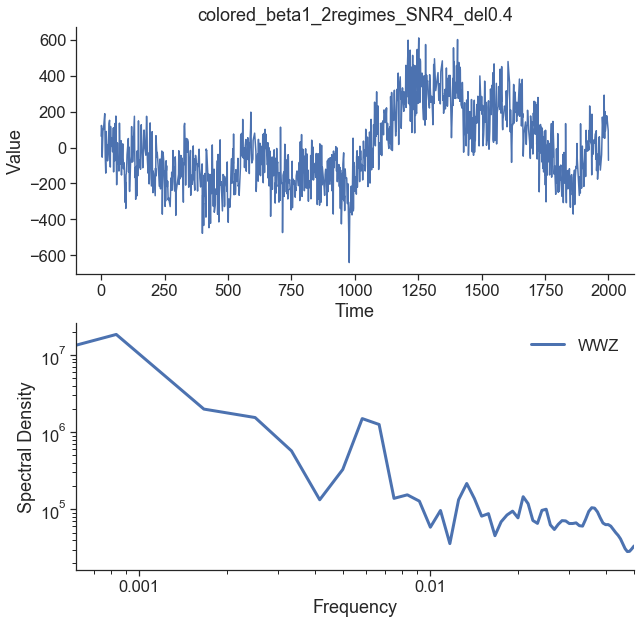

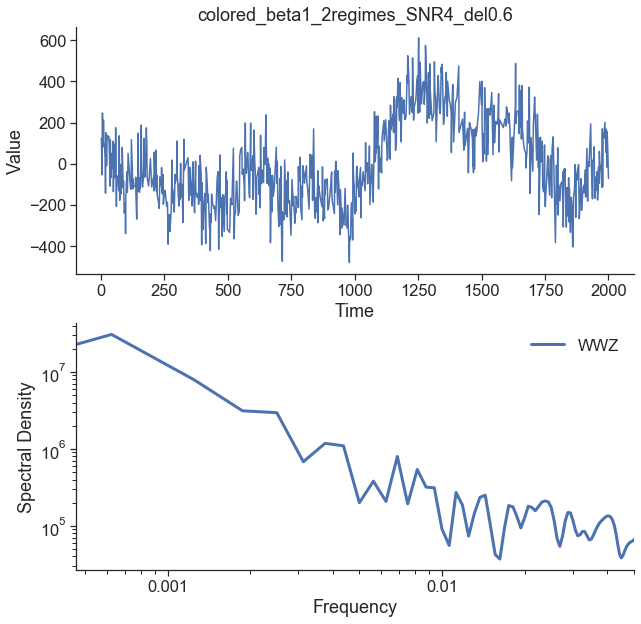

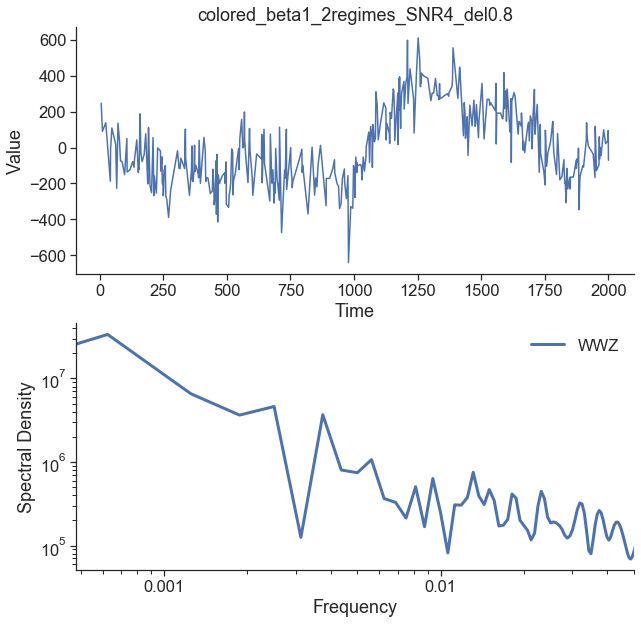

In [10]:
np.random.seed(2333)
case_list = df.columns.values
print(case_list)
for case_tag in tqdm(case_list):
    for del_percent in [0.2, 0.4, 0.6, 0.8]:
        signal = df[case_tag].values
        time = df[case_tag].index
        n_del = int(del_percent*np.size(time))
        deleted_idx = np.random.choice(range(np.size(time)), n_del, replace=False)
        
        time_unevenly =  np.delete(time, deleted_idx)
        signal_unevenly =  np.delete(signal, deleted_idx)

        series = pd.Series(signal_unevenly, index=time_unevenly)
        
        col_tag = f'{case_tag}_del{del_percent}'
        df[col_tag] = series
        
        if 'colored' in case_tag:
            loglog=True
        else:
            loglog=False
            
        fig, res_psd = run_wwz(series, title=col_tag, loglog=loglog)

## add a gap

  0%|          | 0/36 [00:00<?, ?it/s]/home/fzhu/Apps/Pyleoclim_util/pyleoclim/Spectral.py:780: RuntimeWarning: invalid value encountered in less
  Neff_diff[Neff_diff < 0] = 0
 11%|█         | 4/36 [00:11<01:32,  2.88s/it]/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
 17%|█▋        | 6/36 [00:17<01:27,  2.93s/it]/home/fzhu/Apps/miniconda3/envs/py3.7/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
100%|██████████| 36/36 [01:51<00:00,  3.10s/it]


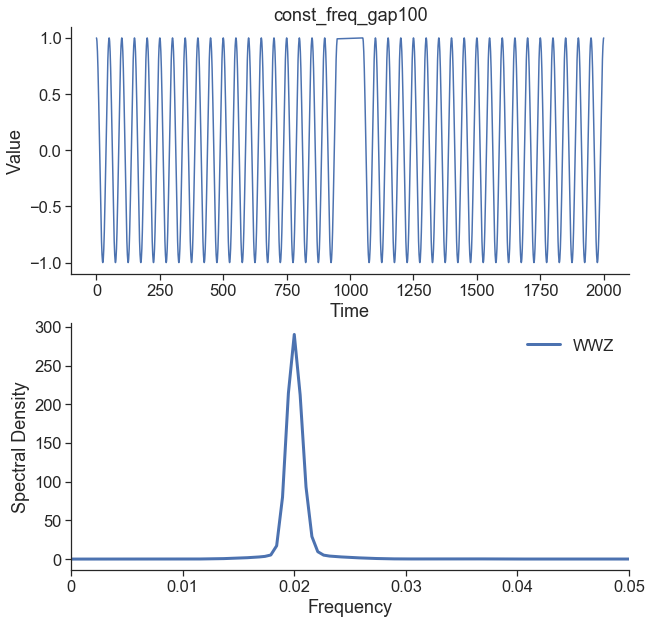

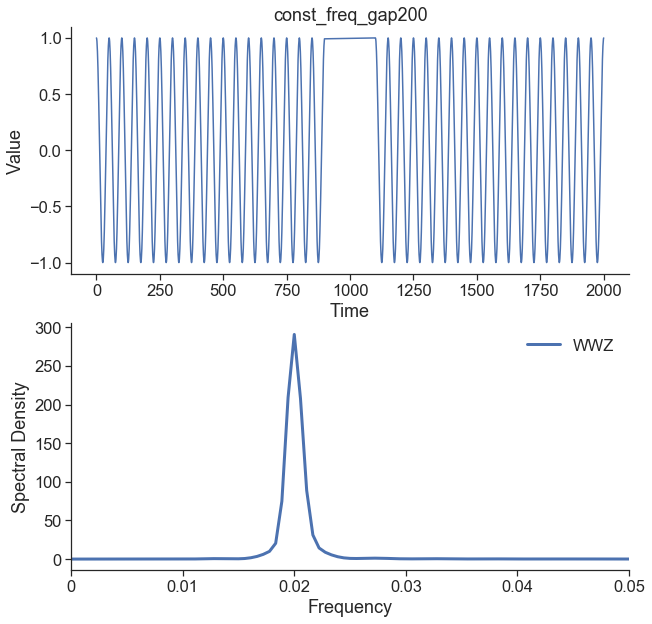

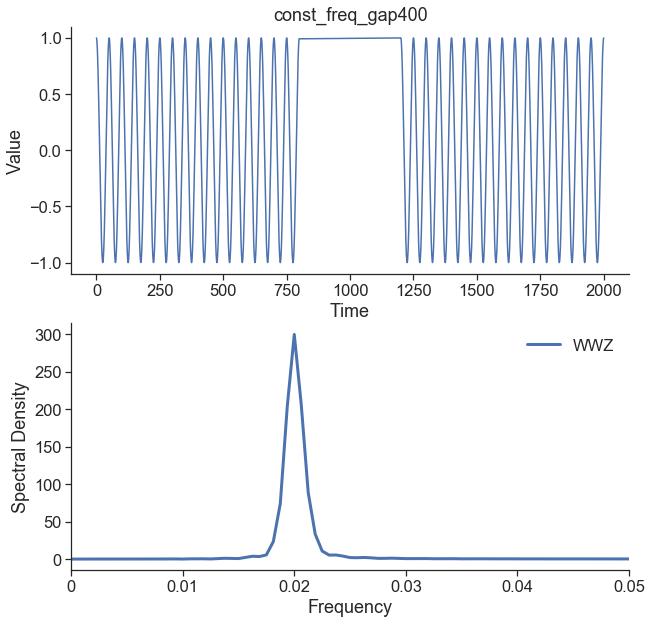

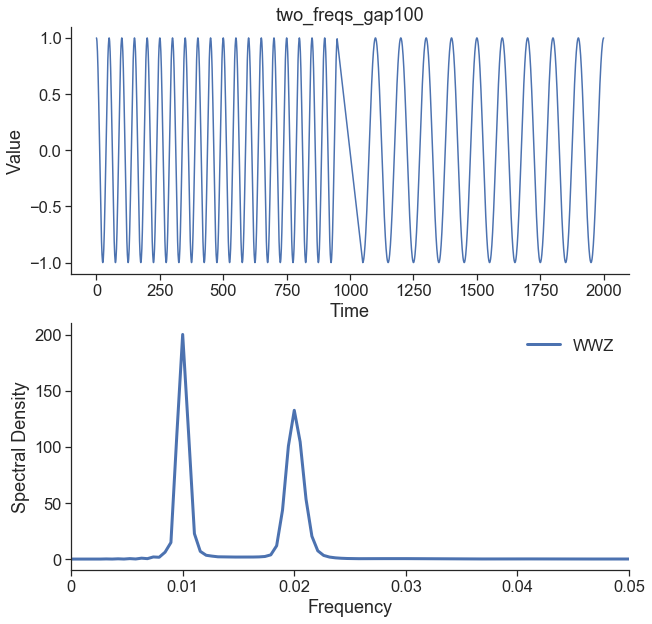

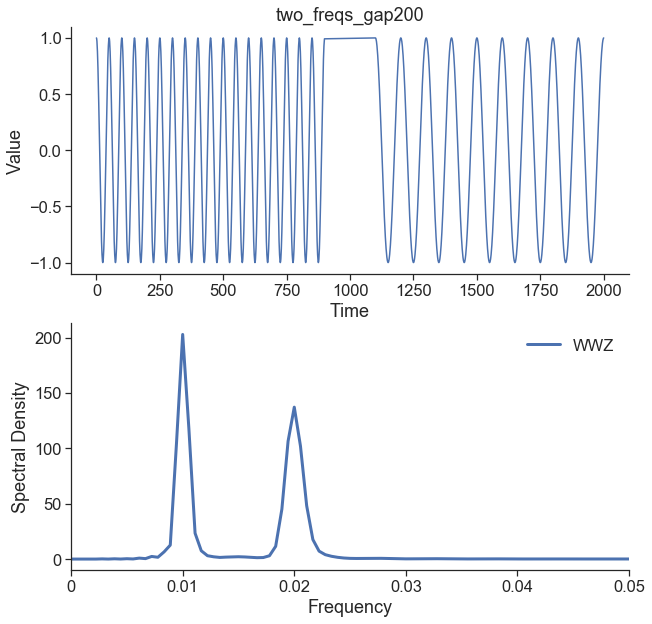

...

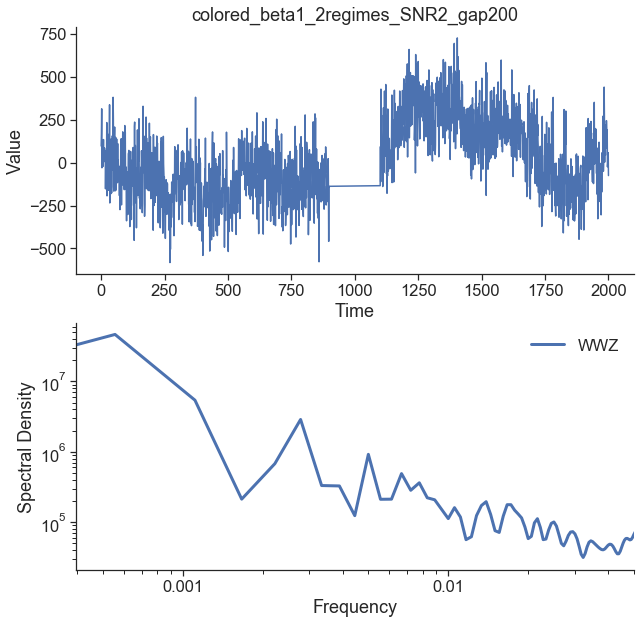

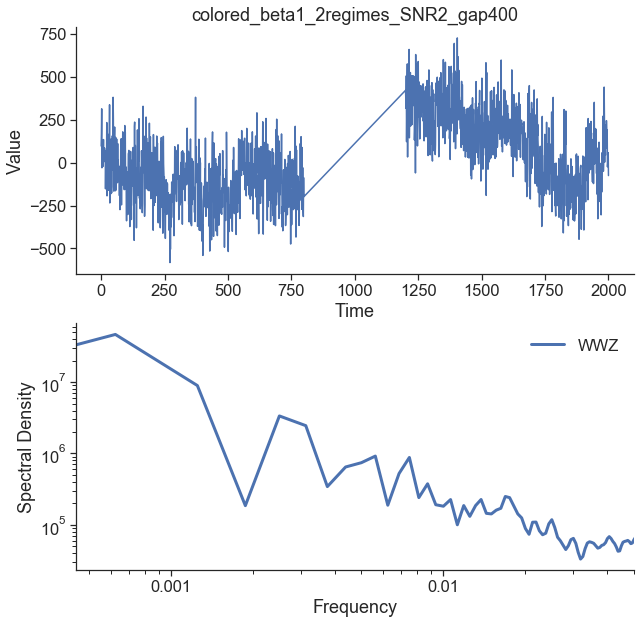

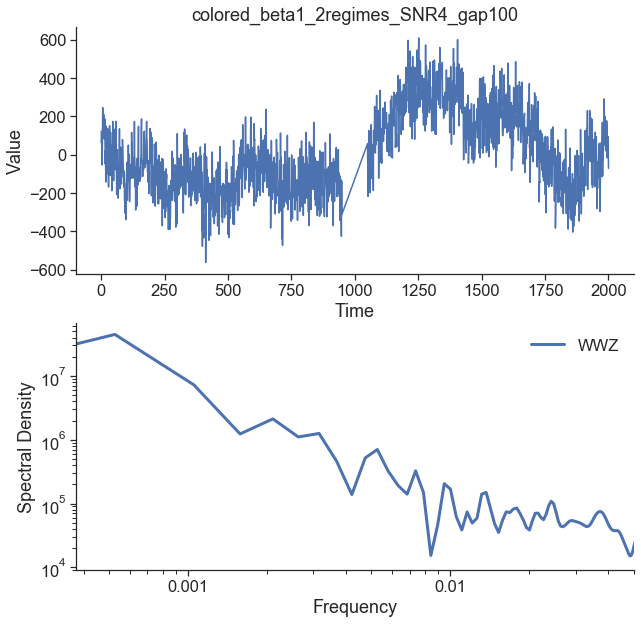

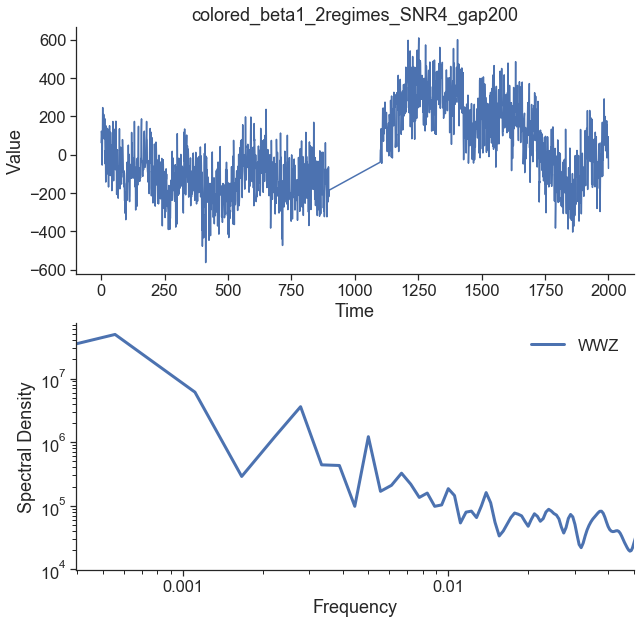

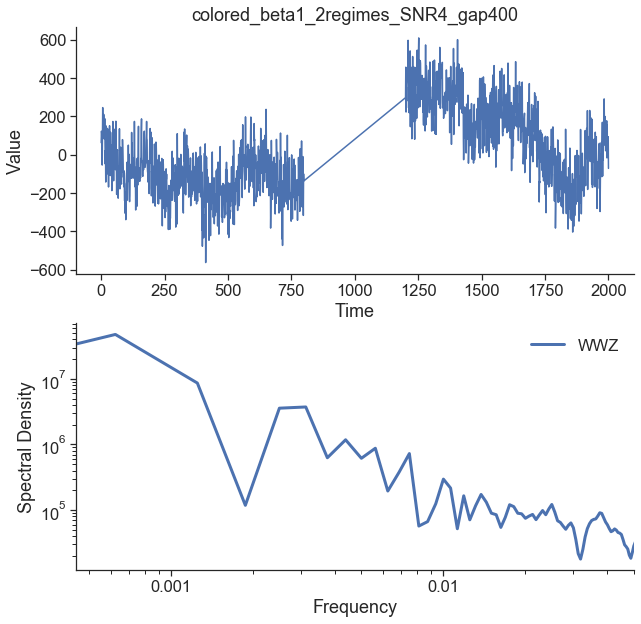

In [14]:
for case_tag in tqdm(case_list):
    for gap_length in [100, 200, 400]:
        signal = df[case_tag].values
        time = df[case_tag].index
        nt = np.size(time)
        deleted_idx = np.arange(nt//2-gap_length//2, nt//2+gap_length//2)
        
        time_unevenly =  np.delete(time, deleted_idx)
        signal_unevenly =  np.delete(signal, deleted_idx)

        series = pd.Series(signal_unevenly, index=time_unevenly)
        
        col_tag = f'{case_tag}_gap{gap_length}'
        df[col_tag] = series
        
        if 'colored' in case_tag:
            loglog=True
        else:
            loglog=False
            
        fig, res_psd = run_wwz(series, title=col_tag, loglog=loglog)

## Output df

In [15]:
print(len(df.columns))
df.to_csv('../test_data/test_data.csv')

288
